In [4]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from tensorflow import keras
from PIL import Image

import warnings
warnings.filterwarnings('ignore')

In [3]:
path = 'PlantVillage/'
categories = os.listdir(path)

print("Number of categories : ", len(categories))
print("Categories are : ")
for c in categories:
    print("\t", c)

Number of categories :  16
Categories are : 
	 Pepper__bell___Bacterial_spot
	 Pepper__bell___healthy
	 PlantVillage
	 Potato___Early_blight
	 Potato___healthy
	 Potato___Late_blight
	 Tomato_Bacterial_spot
	 Tomato_Early_blight
	 Tomato_healthy
	 Tomato_Late_blight
	 Tomato_Leaf_Mold
	 Tomato_Septoria_leaf_spot
	 Tomato_Spider_mites_Two_spotted_spider_mite
	 Tomato__Target_Spot
	 Tomato__Tomato_mosaic_virus
	 Tomato__Tomato_YellowLeaf__Curl_Virus


In [13]:
dict = {
    0:"Pepper__bell___Bacterial_spot",
    1:"Pepper__bell___healthy",
    2:"PlantVillage",
    3:"Potato___Early_blight",
    4:"Potato___healthy",
    5:"Potato___Late_blight",
    6:"Tomato_Bacterial_spot",
    7:"Tomato_Early_blight",
    8:"Tomato_healthy",
    9:"Tomato_Late_blight",
    10:"Tomato_Leaf_Mold",
    11:"Tomato_Septoria_leaf_spot",
    12:"Tomato_Spider_mites_Two_spotted_spider_mite",
    13:"Tomato__Target_Spot",
    14:"Tomato__Tomato_mosaic_virus",
    15:"Tomato__Tomato_YellowLeaf__Curl_Virus"
}

In [10]:
def load_images_labels(categories):
    images = []
    labels = []
    for index, cat in enumerate(categories):
        for img_name in os.listdir(path+"/"+cat)[:300]:
            file_ext = img_name.split(".")[-1]
            if file_ext.lower() == "jpg" or file_ext.lower() == "jpeg":
                img = cv2.imread(path+"/"+cat+"/"+img_name)
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                images.append(img)
                labels.append(index)
    
    return images, labels


images, labels = load_images_labels(categories)
print("No of images loaded : ", len(images))
print("No of labels are : ", len(labels))

No of images loaded :  4352
No of labels are :  4352


In [12]:
images = np.array(images)
labels = np.array(labels)

print("Images shape = ",images.shape,"\nLabels shape = ",labels.shape)
print(type(images),type(labels))

Images shape =  (4352, 256, 256, 3) 
Labels shape =  (4352,)
<class 'numpy.ndarray'> <class 'numpy.ndarray'>


In [15]:
#Random Shuffling
n = np.arange(images.shape[0])
print("'n' values before shuffling = ", n)

np.random.seed(111)
np.random.shuffle(n)
print("\n'n' values after shuffling = ",n)

images = images[n]
labels = labels[n]

'n' values before shuffling =  [   0    1    2 ... 4349 4350 4351]

'n' values after shuffling =  [3063 2450 3854 ... 4182 2004 3924]


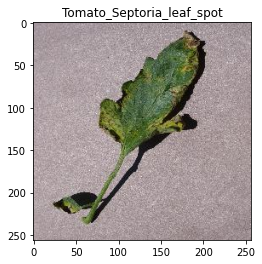

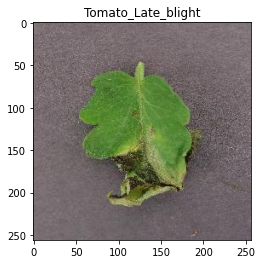

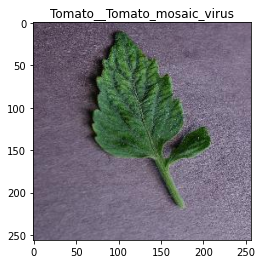

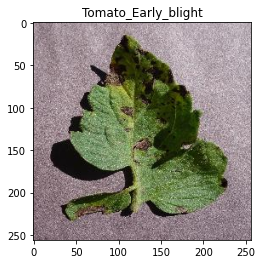

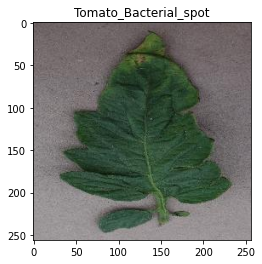

...

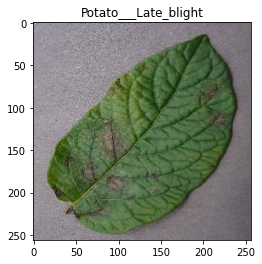

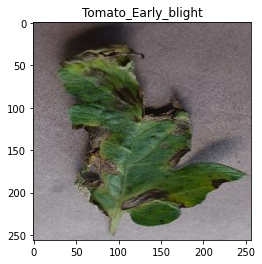

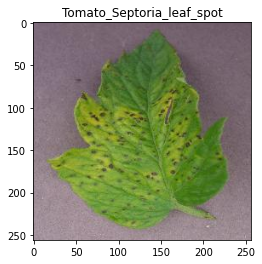

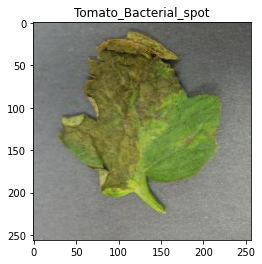

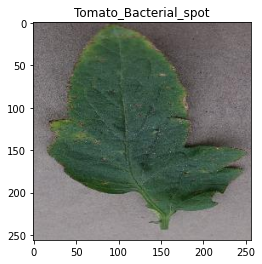

In [17]:
for i in range(200):
    plt.imshow(images[i])
    plt.title(dict[labels[i]])
    plt.show()

In [18]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(images, labels, test_size = 0.2, random_state = 11)

print("x_train shape = ",x_train.shape)
print("y_train shape = ",y_train.shape)
print("\nx_test shape = ",x_test.shape)
print("y_test shape = ",y_test.shape)

x_train shape =  (3481, 256, 256, 3)
y_train shape =  (3481,)

x_test shape =  (871, 256, 256, 3)
y_test shape =  (871,)


In [20]:
from keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten, BatchNormalization

model = keras.Sequential()
model.add(Conv2D(64,kernel_size=(11,11),strides=(4,4),padding="same",activation="relu",input_shape=(256,256,3)))
model.add(MaxPooling2D(pool_size=(3,3)))
model.add(BatchNormalization())
          
model.add(Conv2D(filters=128,kernel_size=(5,5),strides=(1,1),padding="same",activation="relu"))
model.add(MaxPooling2D(pool_size=(3,3)))
model.add(BatchNormalization())  
          
model.add(Conv2D(filters=256,kernel_size=(3,3),strides=(1,1),padding="valid",activation="relu"))
model.add(MaxPooling2D(pool_size=(3,3)))
model.add(BatchNormalization())  
          
model.add(Flatten())
          
model.add(Dense(512,input_shape=(256,256,3),activation="relu"))
model.add(Dropout(0.2))
    
model.add(Dense(256,input_shape=(256,256,3),activation="relu"))
model.add(Dropout(0.2))
          
model.add(Dense(16,activation="softmax"))

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 64, 64, 64)        23296     
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 21, 21, 64)        0         
_________________________________________________________________
batch_normalization (BatchNo (None, 21, 21, 64)        256       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 21, 21, 128)       204928    
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 7, 7, 128)         0         
_________________________________________________________________
batch_normalization_1 (Batch (None, 7, 7, 128)         512       
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 5, 5, 256)         2

In [21]:
model.compile(optimizer="adam", loss="sparse_categorical_crossentropy", metrics=['accuracy'])

In [27]:
history = model.fit(x_train, y_train, epochs=30, validation_split=0.2)

Epoch 1/30
87/87 [==============================] - 32s 369ms/step - loss: 0.5355 - accuracy: 0.8240 - val_loss: 3.3896 - val_accuracy: 0.3917
Epoch 2/30
87/87 [==============================] - 29s 333ms/step - loss: 0.4500 - accuracy: 0.8502 - val_loss: 4.2950 - val_accuracy: 0.3515
Epoch 3/30
87/87 [==============================] - 32s 370ms/step - loss: 0.3805 - accuracy: 0.8768 - val_loss: 1.3186 - val_accuracy: 0.6528
Epoch 4/30
87/87 [==============================] - 27s 308ms/step - loss: 0.2630 - accuracy: 0.9127 - val_loss: 3.5602 - val_accuracy: 0.3888
Epoch 5/30
87/87 [==============================] - 27s 312ms/step - loss: 0.2869 - accuracy: 0.9059 - val_loss: 4.5827 - val_accuracy: 0.3673
Epoch 6/30
87/87 [==============================] - 27s 309ms/step - loss: 0.2252 - accuracy: 0.9221 - val_loss: 6.1420 - val_accuracy: 0.2626
Epoch 7/30
87/87 [==============================] - 27s 312ms/step - loss: 0.2290 - accuracy: 0.9221 - val_loss: 3.2648 - val_accuracy: 0.4161

In [28]:
loss, accuracy = model.evaluate(x_test, y_test)
print("Loss is : ", loss)
print("Accuracy is : ", accuracy*100)

28/28 [==============================] - 2s 75ms/step - loss: 2.1375 - accuracy: 0.6383
Loss is :  2.137549877166748
Accuracy is :  63.834673166275024


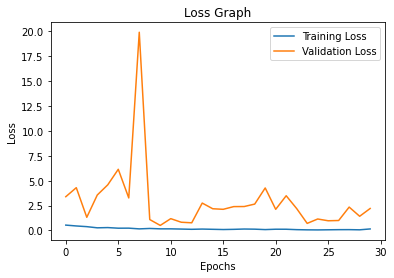

In [29]:
#Loss Graph
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Loss Graph')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

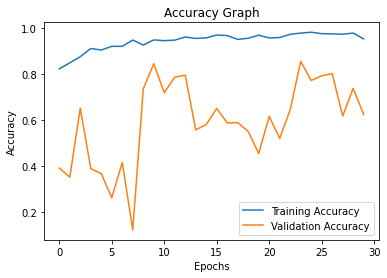

In [30]:
#Accuracy Graph
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy Graph')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()